In [15]:
import matplotlib.pyplot as plt
import pandas as pd
import torch.cuda
import torchvision
import torch.nn as nn
from pathlib import Path

from sympy.stats.rv import probability
from torch.utils.data import DataLoader
from torchvision import transforms


In [16]:
if torch.cuda.is_available():
    device = "cuda"
elif torch.backends.mps.is_available():
    device = "mps"
else :
    device = "cpu"

In [17]:
base_dir = Path("./Vegetable_Images/Vegetable Images")
train_dir = base_dir / "train"
test_dir = base_dir / "test"
val_dir = base_dir / "validation"

In [18]:
class ConvertToRGB(object):
    def __call__(self, img):
        if img.mode != "RGB":
            img = img.convert("RGB")
        return img


In [19]:
transform = transforms.Compose(
    [
        ConvertToRGB(),
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ]
)

In [20]:
from torchvision import datasets

train_dataset = datasets.ImageFolder(root=train_dir, transform=transform)
test_dataset = datasets.ImageFolder(root=test_dir, transform=transform)
val_dataset = datasets.ImageFolder(root=val_dir, transform=transform)

print("Classes:", train_dataset.classes)
print(f"That is {len(train_dataset.classes)} classes")
print(train_dataset[0][0].shape)

Classes: ['Bean', 'Bitter_Gourd', 'Bottle_Gourd', 'Brinjal', 'Broccoli', 'Cabbage', 'Capsicum', 'Carrot', 'Cauliflower', 'Cucumber', 'Papaya', 'Potato', 'Pumpkin', 'Radish', 'Tomato']
That is 15 classes
torch.Size([3, 224, 224])


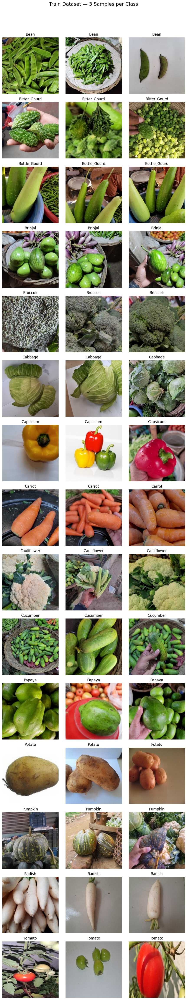

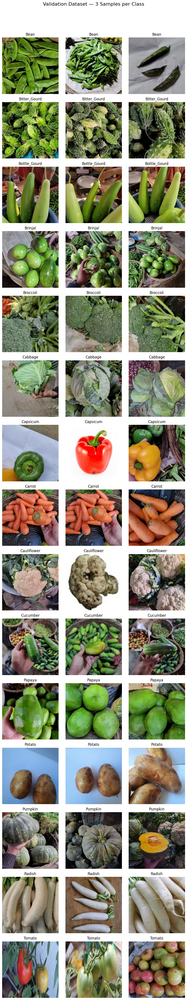

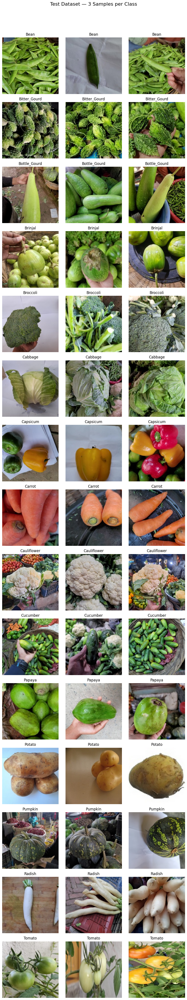

In [21]:
import random
import torch

def show_samples_per_class(dataset, title, samples_per_class=3):
    """Display n random samples for each class in a given dataset."""
    class_indices = {cls: [] for cls in range(len(dataset.classes))}

    # Group indices by class
    for idx, (_, label) in enumerate(dataset.samples):
        class_indices[label].append(idx)

    # Plot
    num_classes = len(dataset.classes)
    plt.figure(figsize=(samples_per_class * 3, num_classes * 3))
    plt.suptitle(title, fontsize=16, y=1.02)

    for cls_idx, cls_name in enumerate(dataset.classes):
        # pick random sample indices for this class
        chosen = random.sample(class_indices[cls_idx], min(samples_per_class, len(class_indices[cls_idx])))

        for j, sample_idx in enumerate(chosen):
            img, label = dataset[sample_idx]
            img = img.permute(1, 2, 0)  # (C, H, W) → (H, W, C)

            ax = plt.subplot(num_classes, samples_per_class, cls_idx * samples_per_class + j + 1)
            ax.imshow(img)
            ax.set_title(cls_name)
            ax.axis("off")

    plt.tight_layout()
    plt.show()


# Show samples for each dataset
show_samples_per_class(train_dataset, "Train Dataset — 3 Samples per Class", samples_per_class=3)
show_samples_per_class(val_dataset, "Validation Dataset — 3 Samples per Class", samples_per_class=3)
show_samples_per_class(test_dataset, "Test Dataset — 3 Samples per Class", samples_per_class=3)


In [22]:
batch_size = 32
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size)
val_loader = DataLoader(val_dataset, batch_size=batch_size)

In [23]:
from tqdm import tqdm

def get_mean_std(loader):
    channels_sum, channels_squared_sum, num_batches = 0, 0, 0
    for data, _ in tqdm(loader, desc="Computing mean and std", leave=False):
        channels_sum += torch.mean(data, dim=[0, 2, 3])
        channels_squared_sum += torch.mean(data ** 2, dim=[0, 2, 3])
        num_batches += 1
    mean = channels_sum / num_batches
    std = torch.sqrt(channels_squared_sum / num_batches - mean**2)

    return mean, std


In [24]:
mean, std = get_mean_std(train_loader)
print(f"Mean: {mean}")
print(f"Std: {std}")

Mean: tensor([0.4688, 0.4635, 0.3434])
Std: tensor([0.2350, 0.2297, 0.2438])


In [25]:
transform_norm = transforms.Compose(
    [
        ConvertToRGB(),
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std),
    ]
)

In [26]:
norm_train_dataset = datasets.ImageFolder(root=train_dir, transform=transform_norm)
norm_test_dataset = datasets.ImageFolder(root=test_dir, transform=transform_norm)
norm_val_dataset = datasets.ImageFolder(root=val_dir, transform=transform_norm)


In [27]:
length = len(norm_train_dataset)
print(f"Length: {length}")

Length: 15000


In [28]:
from collections import Counter

def class_count(dataset):
    c = Counter(x[1] for x in dataset)
    class_to_idx = dataset.class_to_idx
    return pd.Series({cls: c[idx]  for cls, idx  in class_to_idx.items()})


In [29]:
classCount = class_count(norm_train_dataset)

In [30]:
# the class is balanced and evenly distributed

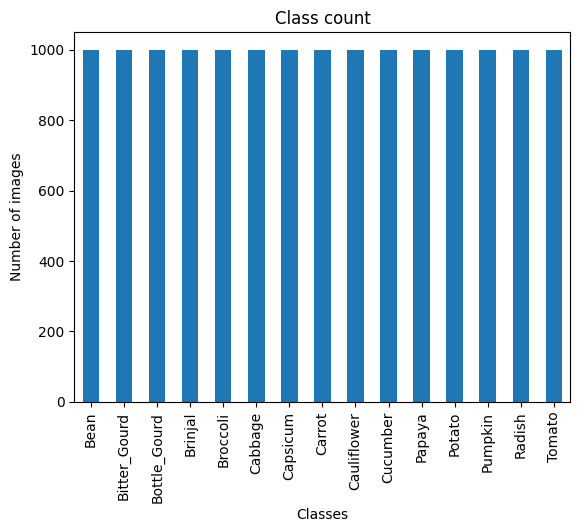

In [31]:
classCount.plot(kind="bar")
plt.xlabel("Classes")
plt.ylabel("Number of images")
plt.title("Class count")
plt.show()

In [32]:
norm_train_loader = DataLoader(norm_train_dataset, batch_size=batch_size, shuffle=True)
norm_val_loader = DataLoader(norm_val_dataset, batch_size=batch_size)
norm_test_loader = DataLoader(norm_test_dataset, batch_size=batch_size)

In [33]:
data_iter = iter(norm_train_loader)
images, labels = next(data_iter)

image_shape = images.shape
print(image_shape)
labels_shape = labels.shape
print(labels_shape)
labels

torch.Size([32, 3, 224, 224])
torch.Size([32])


tensor([ 8,  9,  5,  5,  9,  7, 11, 14, 11,  7,  7, 11,  3,  7,  1,  8,  3, 12,
         7, 13,  1,  1,  6, 14, 14,  5,  0, 10, 10, 13,  7, 12])

In [34]:

from torchinfo import summary
from torchvision import models

# model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
model = models.resnet50(weights=None)

weight_path = "./resnet50-11ad3fa6.pth"
state_dict = torch.load(weight_path)
model.load_state_dict(state_dict)

batch_shape = next(iter(norm_train_loader))[0].shape

summary(model, input_size=batch_shape)

Layer (type:depth-idx)                   Output Shape              Param #
ResNet                                   [32, 1000]                --
├─Conv2d: 1-1                            [32, 64, 112, 112]        9,408
├─BatchNorm2d: 1-2                       [32, 64, 112, 112]        128
├─ReLU: 1-3                              [32, 64, 112, 112]        --
├─MaxPool2d: 1-4                         [32, 64, 56, 56]          --
├─Sequential: 1-5                        [32, 256, 56, 56]         --
│    └─Bottleneck: 2-1                   [32, 256, 56, 56]         --
│    │    └─Conv2d: 3-1                  [32, 64, 56, 56]          4,096
│    │    └─BatchNorm2d: 3-2             [32, 64, 56, 56]          128
│    │    └─ReLU: 3-3                    [32, 64, 56, 56]          --
│    │    └─Conv2d: 3-4                  [32, 64, 56, 56]          36,864
│    │    └─BatchNorm2d: 3-5             [32, 64, 56, 56]          128
│    │    └─ReLU: 3-6                    [32, 64, 56, 56]          --
│ 

In [35]:
# Freeze all layers
for param in model.parameters():
    param.requires_grad = False

In [36]:
num_feat = model.fc.in_features
num_classes = len(norm_train_dataset.classes)
model.fc = nn.Linear(num_feat, num_classes)
model = model.to(device)
print(f"Model modified for {num_classes} classes.")

Model modified for 15 classes.


In [37]:
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [38]:
from training import train_model, eval_model, predict


In [39]:

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
best_val_loss = float("inf")

epochs = 5
for epoch in range(epochs):
    train_loss, train_acc = train_model(model, norm_train_loader, loss_fn, optimizer, device)
    val_loss, val_acc = eval_model(model, norm_val_loader, loss_fn, device)

    train_losses.append(train_loss)
    val_losses.append(val_loss)
    train_accuracies.append(train_acc)
    val_accuracies.append(val_acc)

    # modelCheckpoint
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        torch.save(model.state_dict(), f"best_model.pth")

    print(f"Epoch [{epoch+1}/{epochs}]")
    print(f"  Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.2f}%")
    print(f"  Val Loss:   {val_loss:.4f} | Val Acc:   {val_acc:.2f}%")
    print("-" * 50)



100%|██████████| 94/94 [00:47<00:00,  1.99it/s]


Epoch [1/5]
  Train Loss: 0.0125 | Train Acc: 95.81%
  Val Loss:   0.0639 | Val Acc:   99.60%
--------------------------------------------------


100%|██████████| 94/94 [00:49<00:00,  1.92it/s]


Epoch [2/5]
  Train Loss: 0.0018 | Train Acc: 99.56%
  Val Loss:   0.0284 | Val Acc:   99.77%
--------------------------------------------------


100%|██████████| 94/94 [00:50<00:00,  1.88it/s]


Epoch [3/5]
  Train Loss: 0.0010 | Train Acc: 99.78%
  Val Loss:   0.0197 | Val Acc:   99.87%
--------------------------------------------------


100%|██████████| 94/94 [00:48<00:00,  1.92it/s]


Epoch [4/5]
  Train Loss: 0.0006 | Train Acc: 99.91%
  Val Loss:   0.0131 | Val Acc:   99.80%
--------------------------------------------------


100%|██████████| 94/94 [00:48<00:00,  1.92it/s]

Epoch [5/5]
  Train Loss: 0.0004 | Train Acc: 99.90%
  Val Loss:   0.0096 | Val Acc:   99.93%
--------------------------------------------------


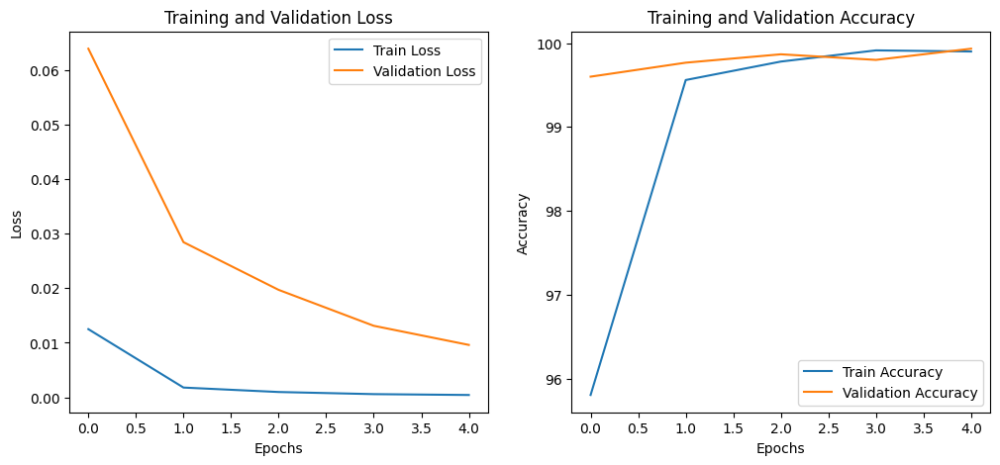

In [40]:
# plot loss and accuracy over epochs
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# plot accuracies over epochs
plt.subplot(1, 2, 2)
plt.plot(train_accuracies, label='Train Accuracy')
plt.plot(val_accuracies, label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show();

In [41]:
checkpoint = torch.load("best_model.pth")
model.load_state_dict(checkpoint)

<All keys matched successfully>

In [42]:
probabilities_val = predict(model, norm_val_loader, device)[0]
predictions_val = torch.argmax(probabilities_val, dim=1)

100%|██████████| 94/94 [00:47<00:00,  2.00it/s]


In [43]:
print(predictions_val[800:880])

tensor([4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
        4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
        4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
        4, 4, 4, 4, 4, 4, 4, 4], device='mps:0')


In [44]:
class_names = train_dataset.classes
predicted_classes = [class_names[idx] for idx in predictions_val[800:850]]
print(predicted_classes)

['Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli', 'Broccoli']


Get Labels: 100%|██████████| 94/94 [00:01<00:00, 51.26it/s]


<Figure size 1000x800 with 0 Axes>

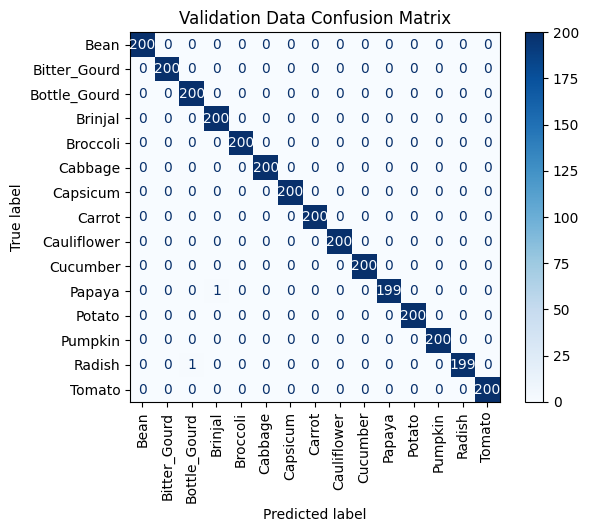

In [45]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

target_test = torch.cat([labels for _, labels in tqdm(norm_val_loader, desc="Get Labels")])

cm = confusion_matrix(target_test.cpu(), predictions_val.cpu())
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=test_dataset.classes)

plt.figure(figsize=(10,8))
disp.plot(cmap=plt.cm.Blues, xticks_rotation='vertical');
plt.title("Validation Data Confusion Matrix")
plt.show();

In [46]:
probabilities_test = predict(model, norm_test_loader, device)[0]
predictions_test = torch.argmax(probabilities_test, dim=1)
print(predictions_test)

100%|██████████| 94/94 [00:47<00:00,  2.00it/s]


tensor([ 0,  0,  0,  ..., 14, 14, 14], device='mps:0')


In [47]:
print(predictions_test[200:300])


tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1], device='mps:0')


Get Labels: 100%|██████████| 94/94 [00:02<00:00, 41.64it/s]


<Figure size 1000x800 with 0 Axes>

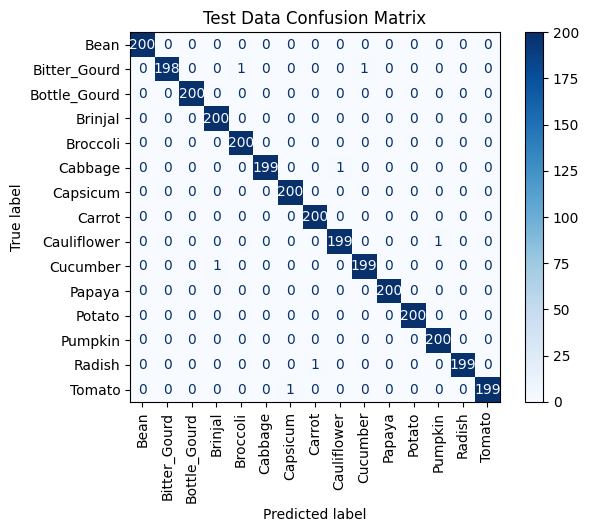

In [48]:
target_test = torch.cat([labels for _, labels in tqdm(norm_test_loader, desc="Get Labels")])

cm = confusion_matrix(target_test.cpu(), predictions_test.cpu())
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=test_dataset.classes)

plt.figure(figsize=(10,8))
disp.plot(cmap=plt.cm.Blues, xticks_rotation='vertical');
plt.title("Test Data Confusion Matrix")
plt.show();

In [49]:
from sklearn.metrics import classification_report

y_true = target_test.cpu()
y_pred = predictions_test.cpu()

summary = classification_report(y_true, y_pred, target_names=test_dataset.classes, digits=4)
print(summary)

              precision    recall  f1-score   support

        Bean     1.0000    1.0000    1.0000       200
Bitter_Gourd     1.0000    0.9900    0.9950       200
Bottle_Gourd     1.0000    1.0000    1.0000       200
     Brinjal     0.9950    1.0000    0.9975       200
    Broccoli     0.9950    1.0000    0.9975       200
     Cabbage     1.0000    0.9950    0.9975       200
    Capsicum     0.9950    1.0000    0.9975       200
      Carrot     0.9950    1.0000    0.9975       200
 Cauliflower     0.9950    0.9950    0.9950       200
    Cucumber     0.9950    0.9950    0.9950       200
      Papaya     1.0000    1.0000    1.0000       200
      Potato     1.0000    1.0000    1.0000       200
     Pumpkin     0.9950    1.0000    0.9975       200
      Radish     1.0000    0.9950    0.9975       200
      Tomato     1.0000    0.9950    0.9975       200

    accuracy                         0.9977      3000
   macro avg     0.9977    0.9977    0.9977      3000
weighted avg     0.9977   

In [50]:
# For each class, almost every test image was classified correctly.

# The model’s precision, recall, and F1-score are effectively ~100% across all classes.

# This could also mean the model is overfitting on the given data especially due to similar in shots of each classes in train, validation and test datasets.

In [51]:
# Real word use case of this classification

# 1. Food Supply Chain Automation
#  -In markets, supermarkets, and packaging centers, this model can classify vegetables on conveyor belts.
#  -By integrating freshness and defect detection, it can automatically separate spoiled or damaged vegetables before distribution.

# 2. Sustainability and Food Waste Reduction
#  -Automated sorting can identify spoiled vs. fresh produce early.
#  -Reducing waste helps both environmental sustainability and food security.

# 3. Foundation for Broader AI Ecosystems
#  -Your classifier can become a base model for:
#  -Disease detection systems (spotting fungal infections or nutrient deficiencies)
#  -Yield prediction tools
# -Smart marketplace apps for crop identification and price estimation
